# YOLOv8
YOLOv8 is the newest state-of-the-art YOLO model that can be used for object detection, image classification, and instance segmentation tasks.<br>
YOLOv8 includes numerous architectural and developer experience changes and improvements over YOLOv5.<br>

## Why Should I Use YOLOv8?
* YOLOv8 has a high rate of accuracy measured by COCO and Roboflow 100.
* YOLOv8 comes with a lot of developer-convenience features, from an easy-to-use CLI to a well-structured Python package.

## Install ultralytics

In [5]:
# Install ultralytics
!pip install ultralytics

^C


In [25]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
import random
import os
import cv2
import shutil
import tqdm
import glob

# Train Custom Model

In [9]:
from ultralytics import YOLO

# load pre-trained model
model = YOLO("yolov5s.pt")
model.train(data='data.yaml', epochs=1)

PRO TIP  Replace 'model=yolov5s.pt' with new 'model=yolov5su.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.

100%|██████████| 17.7M/17.7M [00:10<00:00, 1.73MB/s]
Ultralytics YOLOv8.0.74  Python-3.11.2 torch-2.0.0+cpu CPU
yolo\engine\trainer: task=detect, mode=train, model=yolov5s.pt, data=data.yaml, epochs=1, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=0, resume=False, amp=True, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=F

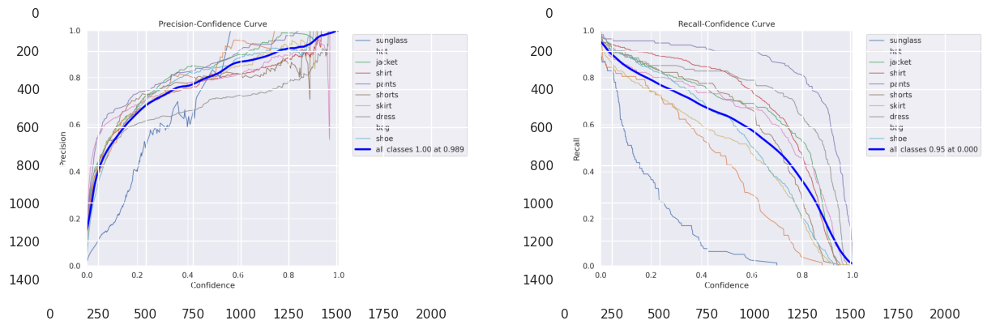

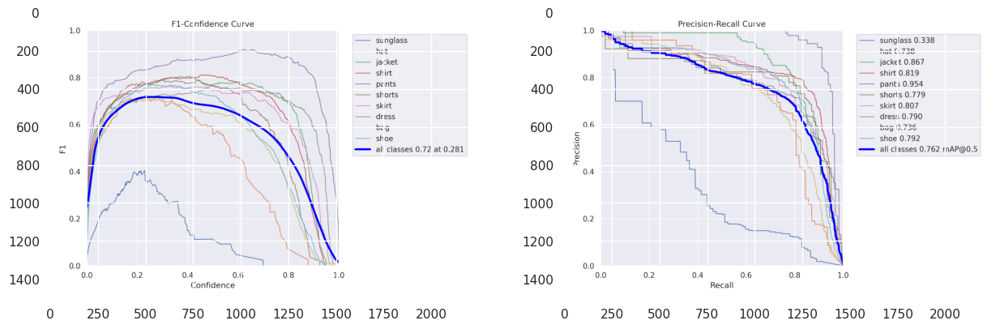

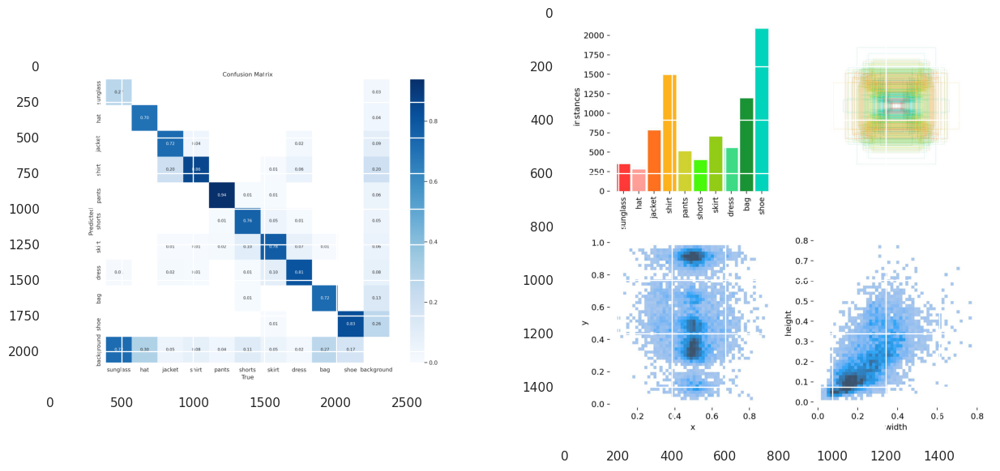

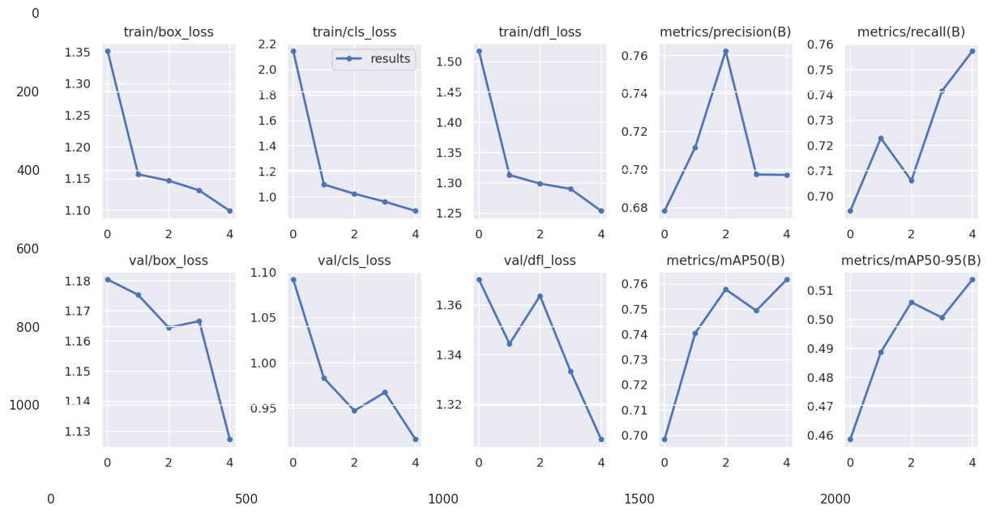

In [24]:
%matplotlib inline
model_path = 'runs/detect/train/'

def plot(ls, size):
    c=1
    plt.figure(figsize=(15,10))
    for im in ls:
        plt.subplot(size[0],size[1],c)
        im = plt.imread(model_path+im)
        plt.imshow(im)
        c+=1
    plt.show()

plot(['P_curve.png','R_curve.png'], (1,2))
plot(['F1_curve.png','PR_curve.png'], (1,2))
plot(['confusion_matrix.png','labels.jpg'], (1,2))
plot(['results.png'],(1,1))

In [26]:


test = './split/test/images/'


image 1/1 C:\Users\moizh\Desktop\MLtest\split\test\images\40471.jpg: 640x448 1 shirt, 1 skirt, 2 bags, 2 shoes, 411.9ms
Speed: 4.0ms preprocess, 411.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict

image 1/1 C:\Users\moizh\Desktop\MLtest\split\test\images\42671.jpg: 640x448 1 shirt, 1 skirt, 371.7ms
Speed: 2.0ms preprocess, 371.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict

image 1/1 C:\Users\moizh\Desktop\MLtest\split\test\images\79342.jpg: 640x448 1 shirt, 1 skirt, 1 bag, 1 shoe, 382.0ms
Speed: 2.0ms preprocess, 382.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict

image 1/1 C:\Users\moizh\Desktop\MLtest\split\test\images\84364.jpg: 640x448 1 jacket, 2 shirts, 1 skirt, 1 bag, 1 shoe, 377.0ms
Speed: 2.0ms preprocess, 377.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\d

<Figure size 2000x2000 with 0 Axes>

<Figure size 2000x2000 with 0 Axes>

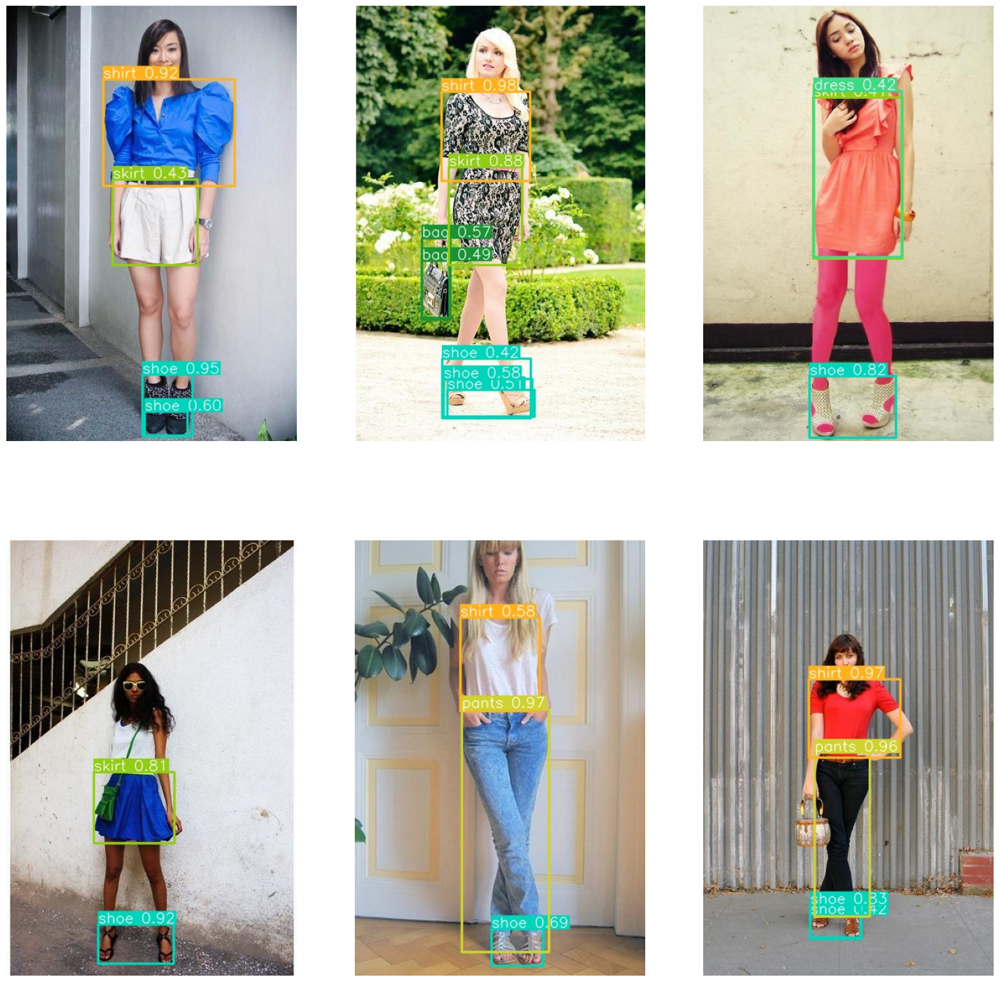

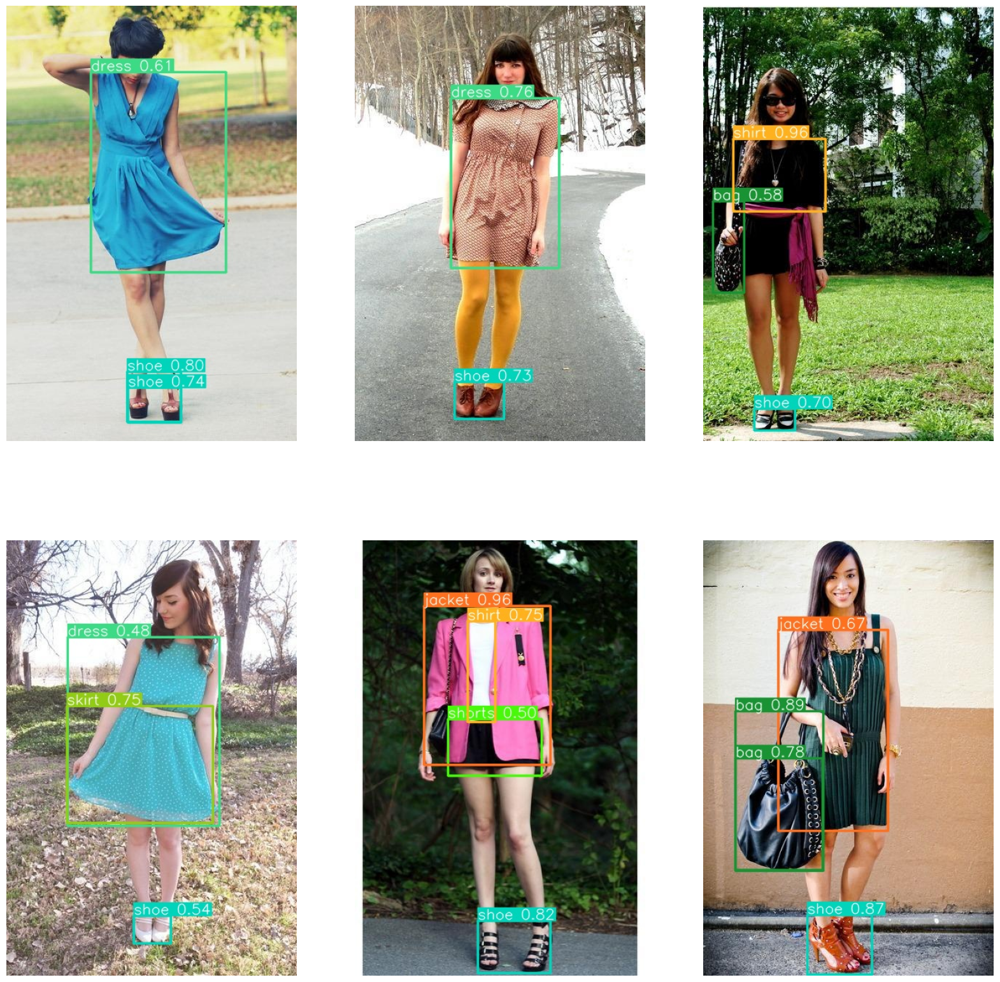

<Figure size 2000x2000 with 0 Axes>

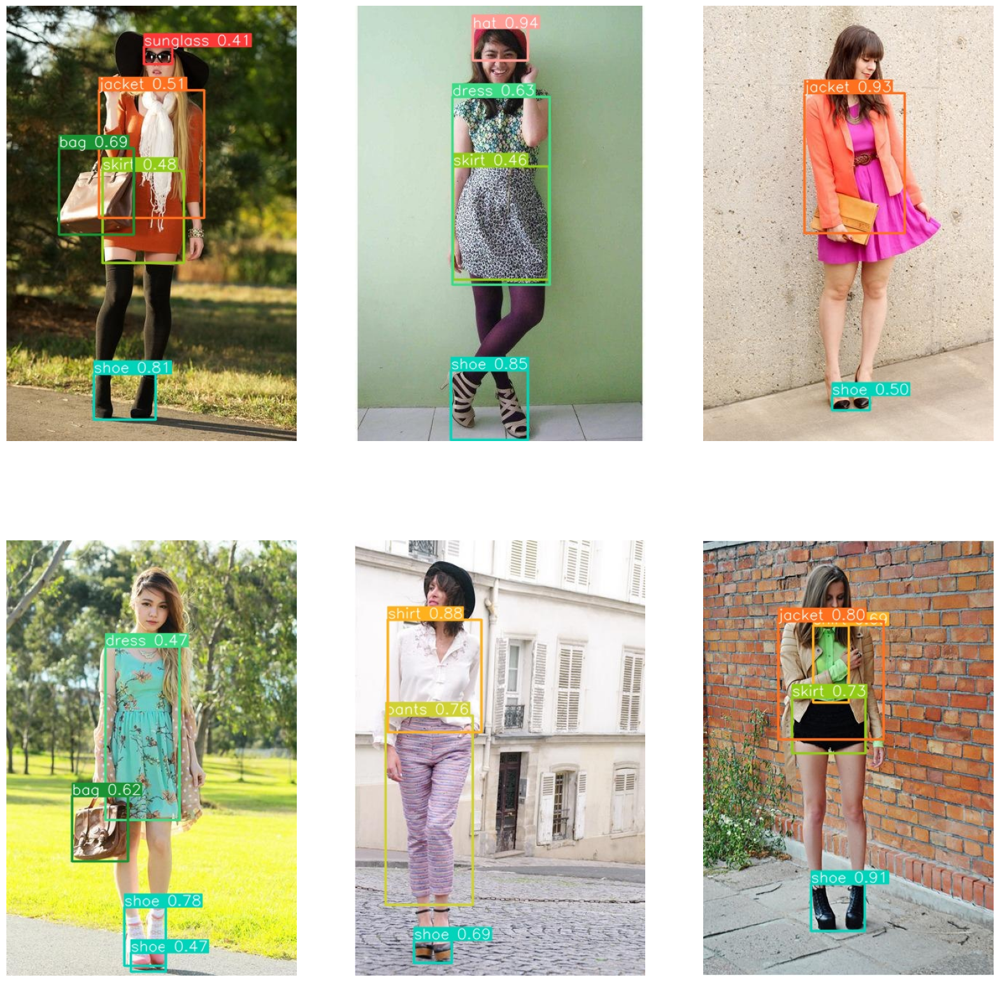

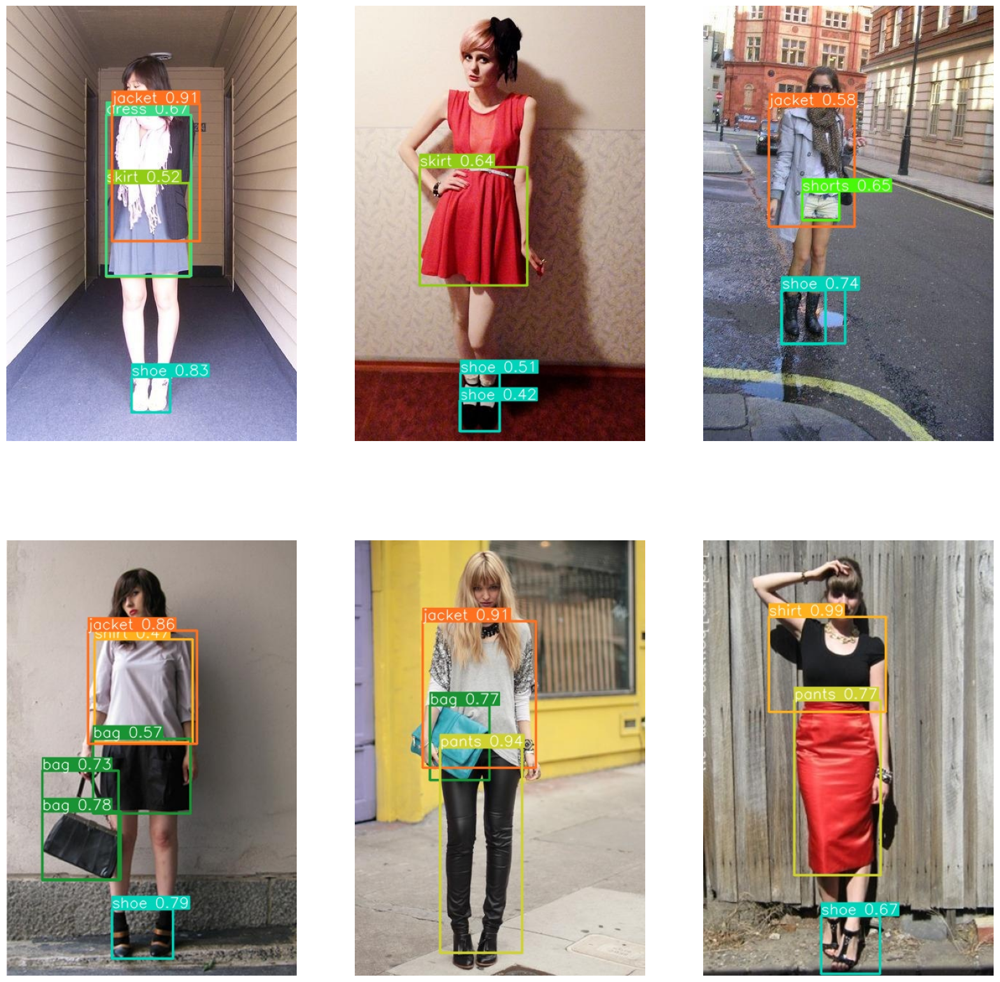

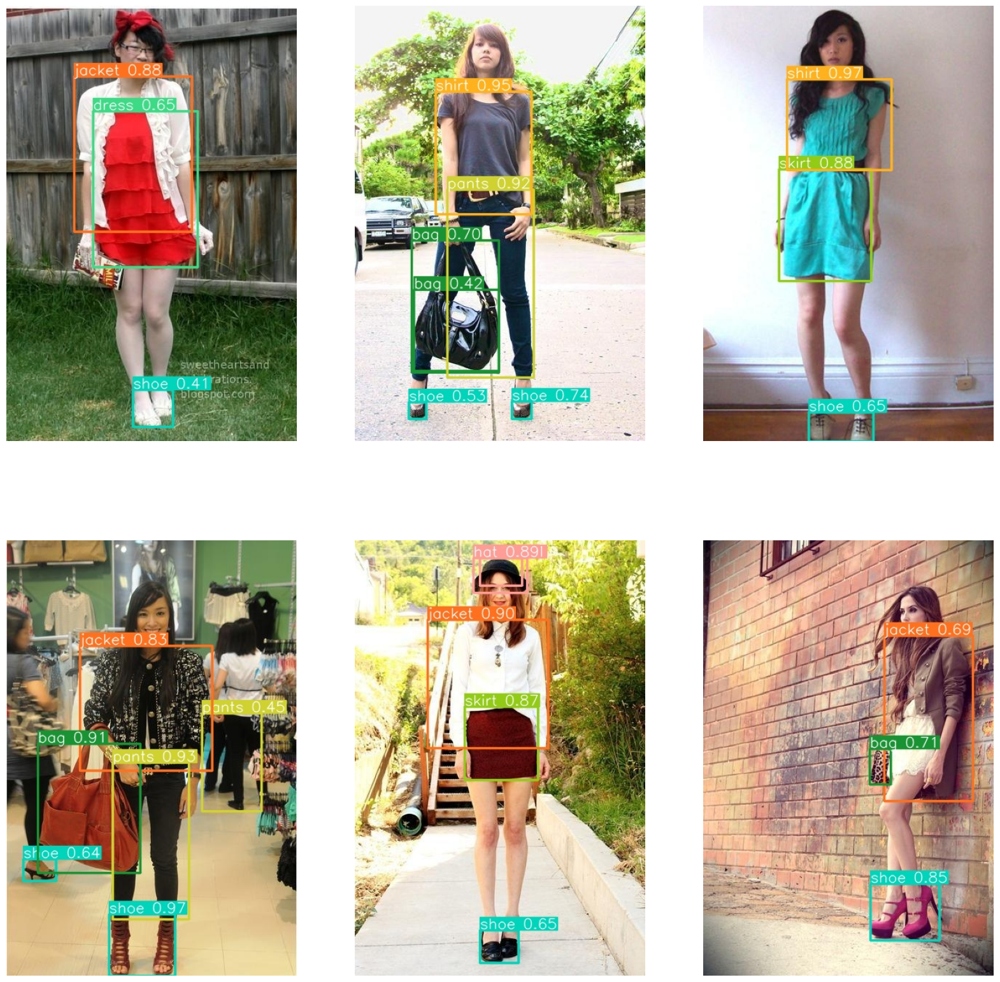

<Figure size 2000x2000 with 0 Axes>

<Figure size 2000x2000 with 0 Axes>

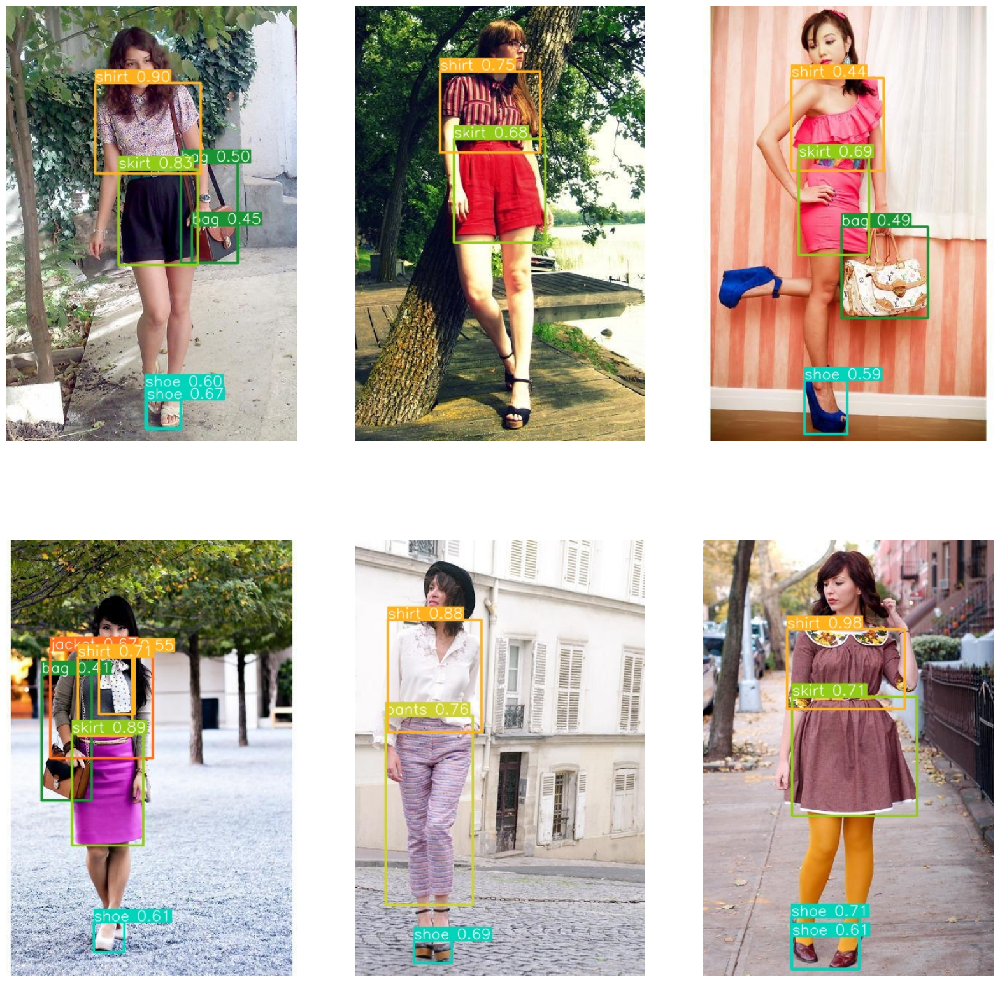

In [27]:
# chosing random image from dataset and getting predection
plt.figure(figsize=(20,20))
imgs = random.sample(os.listdir(test), 6)
c=1
for img in imgs:
    i=model.predict(source=test+img, conf=0.4, save=True, line_thickness=2)

    im = plt.imread('./runs/detect/predict/'+img)
    plt.subplot(2,3,c)
    plt.axis('off')
    plt.imshow(im)
    c+=1